# Register single-subject macaque T1 images to NMTv2.0asym template using ANTs
The method presented here involves changing the coordinate origin as a preparatory step.
No brain extraction it performed.
## 0. Preparations
### 0a. Imports

In [4]:
import os
import shutil
import subprocess
import numpy as np
import pandas as pd
import nibabel as nib
from nilearn import plotting
import nipype.interfaces.ants as ants
from registration_utils import register_linear, register_SyN, overlay_contours

### 0b. Set up paths

In [5]:
# Path to AFNI executables
AFNI_BIN = '/usr/local/AFNI' 

# Path to template files (MODIFY if needed)
template_dir = "/home/nsirmpilatze/home@dpz/afids/templates"
# NMTv2.0asym template
template = os.path.join(template_dir, "NMTv2.0asym.nii.gz")

# Path to 16 single-subject T1w images from PRIME-DE (MODIFY if needed)
subjects_dir = "/home/nsirmpilatze/home@dpz/afids/single-subjects"
# List of paths to individual images
subject_imgs = [
    os.path.join(subjects_dir, img)
    for img in os.listdir(subjects_dir)
    if img.endswith(".nii.gz")
]
subject_imgs.sort()
# List of subject IDs
subjects = [os.path.basename(img).split("_")[0] for img in subject_imgs]
print(f"Subjects: {subjects}")

# Path to folder with fiducial placements (Fid32)
fid32_dir = os.path.join(subjects_dir, "Fid32")

# Set output directory (MODIFY if needed)
out_dir = os.path.join(subjects_dir, "registered")

Subjects: ['sub-032104', 'sub-032105', 'sub-032107', 'sub-032108', 'sub-032198', 'sub-032199', 'sub-032201', 'sub-032203', 'sub-032209', 'sub-032210', 'sub-032211', 'sub-032212', 'sub-032213', 'sub-032214', 'sub-032215', 'sub-032216']


## 1. Copy image files
To avoid modifying the originals

In [6]:
subject_imgs_copy = []
for i, img in enumerate(subject_imgs):
    subject = subjects[i]
    img_copy = os.path.join(out_dir, f"{subject}_T1.nii.gz")
    shutil.copy(img, img_copy)
    subject_imgs_copy.append(img_copy)
    print(f"Image copied for {subject}")

Image copied for sub-032104
Image copied for sub-032105
Image copied for sub-032107
Image copied for sub-032108
Image copied for sub-032198
Image copied for sub-032199
Image copied for sub-032201
Image copied for sub-032203
Image copied for sub-032209
Image copied for sub-032210
Image copied for sub-032211
Image copied for sub-032212
Image copied for sub-032213
Image copied for sub-032214
Image copied for sub-032215
Image copied for sub-032216


## 2. Reset the coordinate origin to the location of PMJ
PMJ is close to the coordinate orginin of NMTv2.0asym. This will help to initialize registration with reasonable overlaps

### 2a. Let's visualize the mean PMJ location across raters
For visualization we use `nilearn`, which treats the coordinates the same as `Slicer` - **RAS**

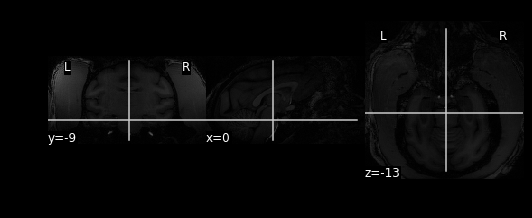

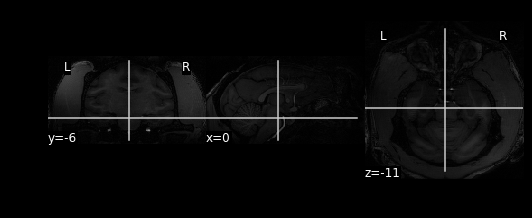

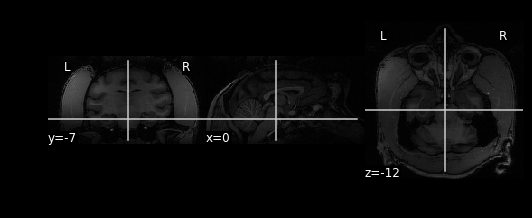

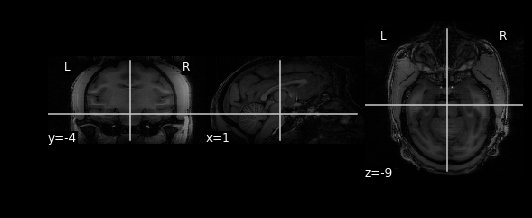

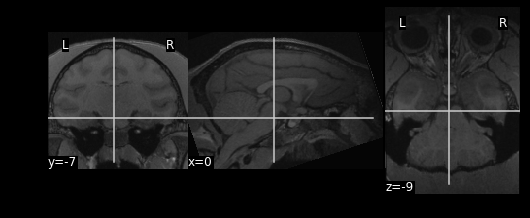

...

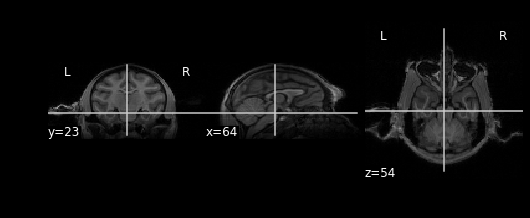

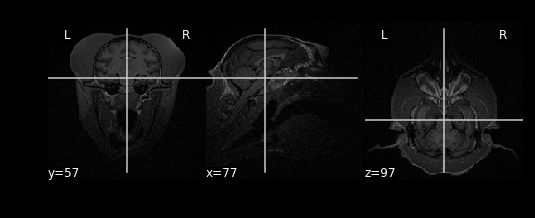

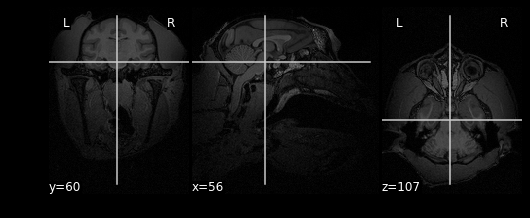

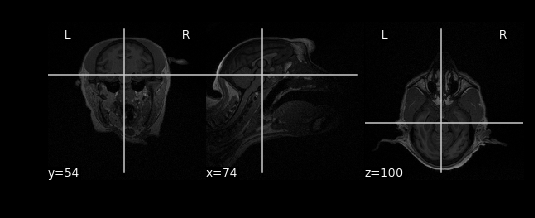

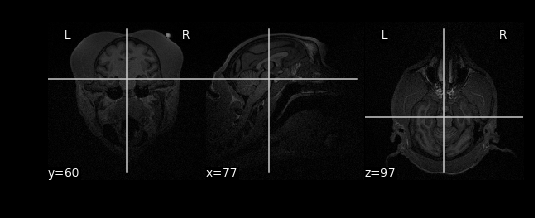

In [7]:
# Number of images (single-subject T1s)
N_imgs = len(subject_imgs_copy) 
# Empty array to hold mean PMJ coords per image
imgs_PMJ = np.empty((N_imgs, 3)) 

for i, img in enumerate(subject_imgs_copy):
    subject = subjects[i]
    # List of Fid32 placement sets for a given image
    fids = [f for f in os.listdir(fid32_dir) if subject in f] 
    N_sets = len(fids) 
    # Empty array to hold mean PMJ coords per placement
    PMJ = np.empty((N_sets, 3)) 

    for j, fid in enumerate(fids):
        # Read Fid32 table
        df = pd.read_csv(os.path.join(fid32_dir, fid), skiprows=2, names=None)
        # Extract x, y, z coords for PMJ
        PMJ[j, :] = df.iloc[3, 1:4].values
    # Compute mean PMJ coords
    imgs_PMJ[i, :] = np.mean(PMJ, axis=0)

    # Plot mean PMJ coordinate
    orig_x, orig_y, orig_z = imgs_PMJ[i, :]
    plotting.plot_anat(img, cut_coords=[orig_x, orig_y, orig_z])

# save mean PMJ coordinates
np.savetxt(os.path.join(out_dir, 'PMJ_coords_mean.txt'), imgs_PMJ, fmt='%.6f')

### 2b. Set coordinate origin to the mean location of PMJ
A **important note** on coordinate systems:

Both `Slicer` (which we used to define the fiducials) and `nilearn` (which we use here for visualization) treat the coordinates according to the **RAS** convention, meaning:

* x-axis: left-to-right
* y-axis: posterior-to-anterior
* z-axis: inferior-to-superior

For resetting the coordinate origin, we will use a command from `AFNI`, which by default follows another convention, which it calls **RAI**-dicom. **CAUTION**: `AFNI` follows a different naming logic for the axes, so **RAI**-dicom here means the following:

* x-axis: right-to-left
* y-axis: anterior-to-posterior
* z-axis: inferior-to-superior

This means that to "translate" our PMJ coordinates from `Slicer` **RAS** to `AFNI` **RAI** (equivalent to **LPS** per `Slicer's` naming convention) we need to flip the first 2 coordinates (along axis x and y).


In [8]:
for i, img in enumerate(subject_imgs_copy):
    # PMJ coordinates in Slicer/nilearn RAS:
    orig_x, orig_y, orig_z = imgs_PMJ[i, :] 
    # Same coordinates expressed in AFNI RAI /Slicer-nilearn LPS (flip first 2 axes)
    orig_x, orig_y, orig_z = -orig_x, -orig_y, orig_z 
    
    # To set the PMJ location to [0, 0, 0], we need to subtract it from the current origin
    # This means shifting the origin along each axis by MINUS the PMJ coordinate
    cmd = f"{AFNI_BIN}/3drefit -quiet -dxorigin {-orig_x} -dyorigin {-orig_y} -dzorigin {-orig_z} {img}"
    subprocess.run(cmd, shell=True)

### 2c. Visualize the new coordinate origin
If step 2b worked, the `[0, 0, 0]` coordinate should coincide with the PMJ

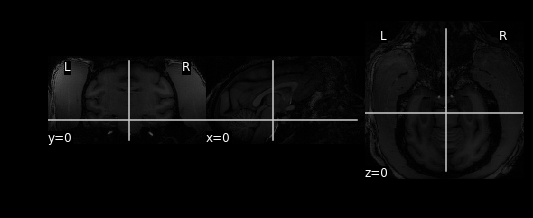

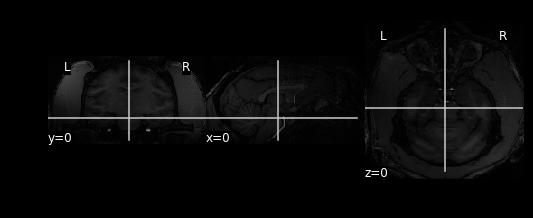

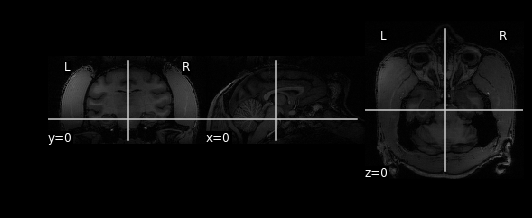

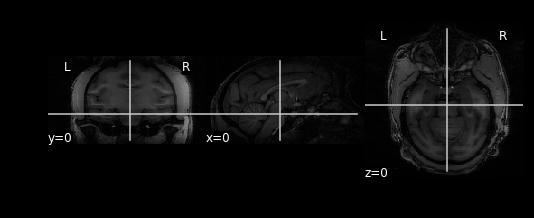

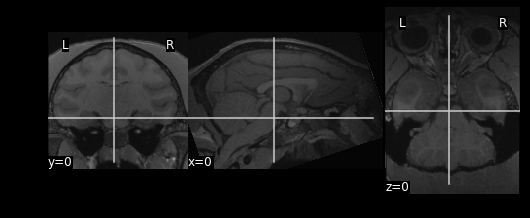

...

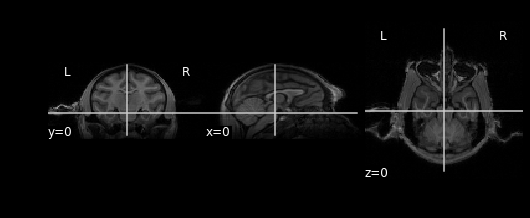

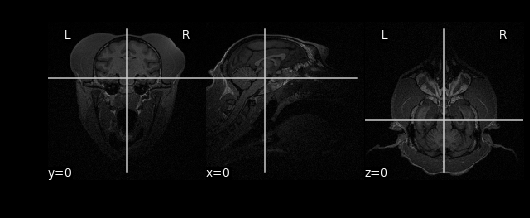

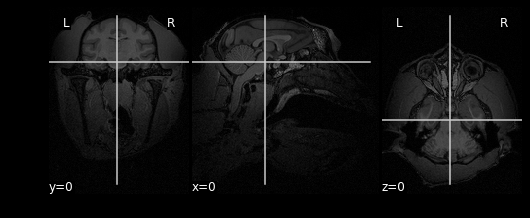

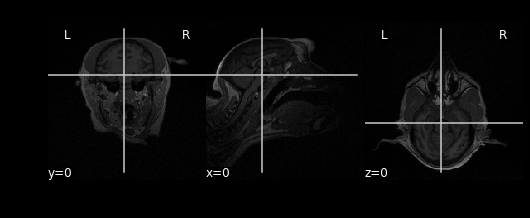

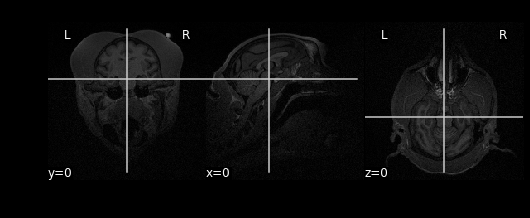

In [9]:
for i, img in enumerate(subject_imgs_copy):
    plotting.plot_anat(img, cut_coords=[0, 0, 0])

## 3. Register the single-subject images to the NMTv2.0asym template
### 3a. First perform a linear (affine, 12 DOF) registration
The registration will be initialized at the coordinate origins

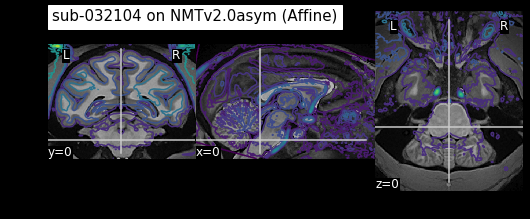

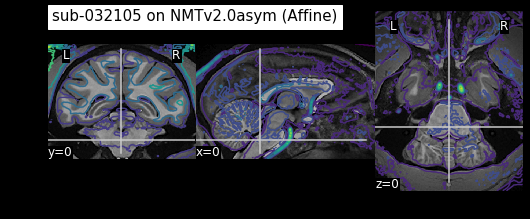

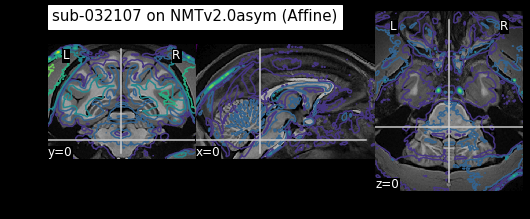

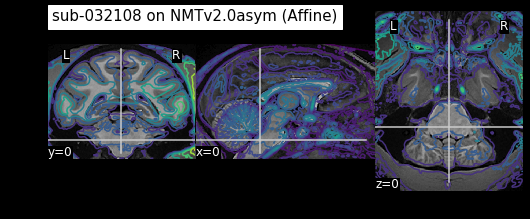

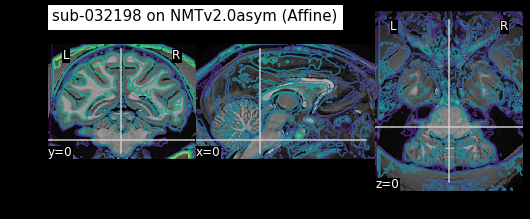

...

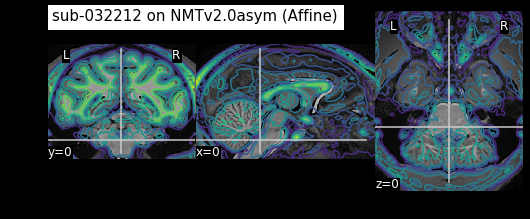

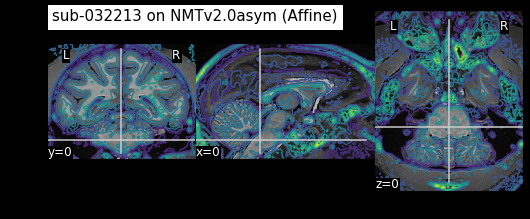

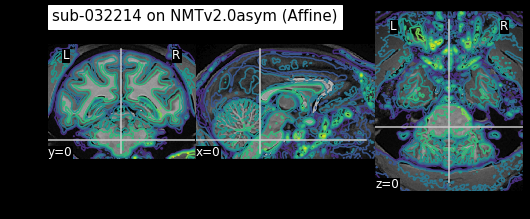

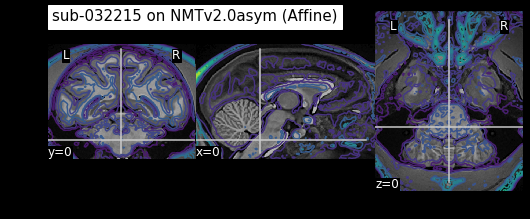

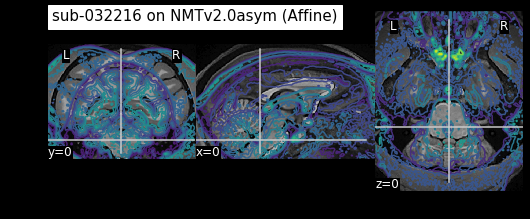

In [11]:
for i, img in enumerate(subject_imgs_copy):
    subject = subjects[i]
    register_linear(
        img,
        template,
        f"{out_dir}/{subject}_to_NMTv2.0asym_",
        transform="Affine"
    )
    img_transformed = f"{out_dir}/{subject}_to_NMTv2.0asym_Affine_Transformed.nii.gz"
    overlay_contours(
        template,
        img_transformed,
        plot_title=f"{subject} on NMTv2.0asym (Affine)",
        save_plot=f"{out_dir}/{subject}_to_NMTv2.0asym_Affine.png",
    )

### 3b. Follow up with non-linear (SyN) registration
The registration will start from the linearly aligned image

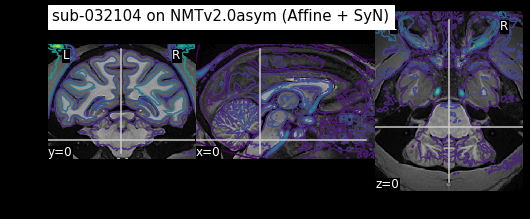

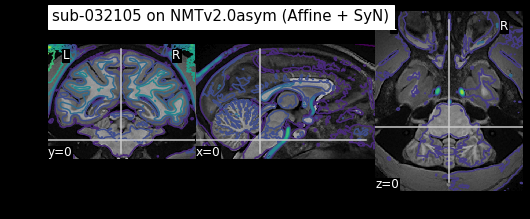

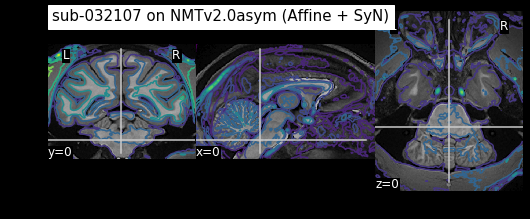

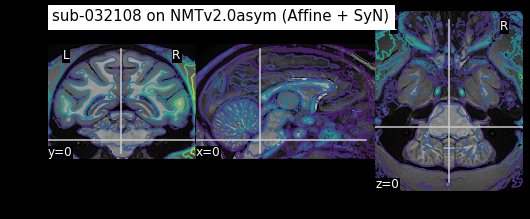

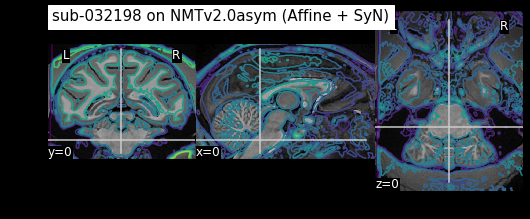

...

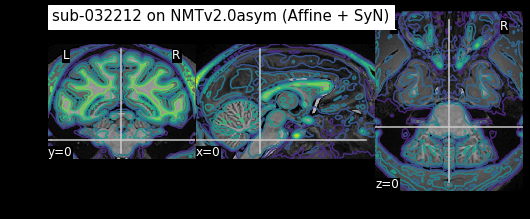

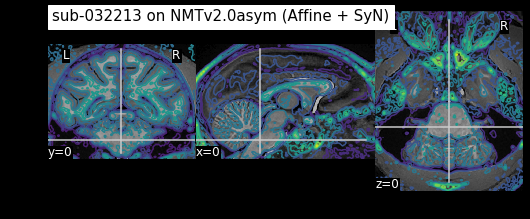

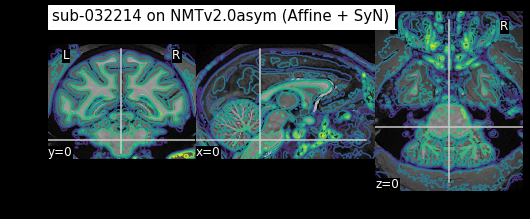

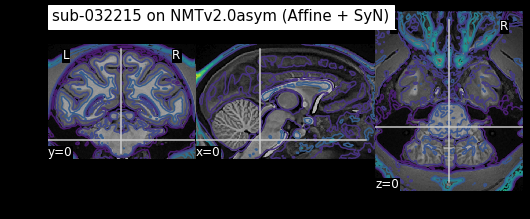

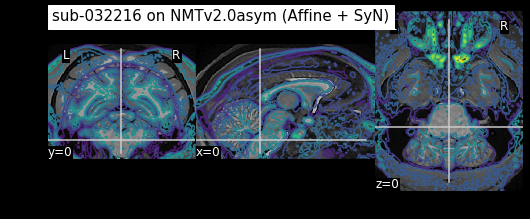

In [13]:
for i, img in enumerate(subject_imgs_copy):
    subject = subjects[i]
    img_transformed_aff = f"{out_dir}/{subject}_to_NMTv2.0asym_Affine_Transformed.nii.gz"
    register_SyN(
        img_transformed_aff,
        template,
        f"{out_dir}/{subject}_to_NMTv2.0asym_"
    )
    img_transformed_syn = f"{out_dir}/{subject}_to_NMTv2.0asym_SyN_Transformed.nii.gz"
    overlay_contours(
        template,
        img_transformed_syn,
        plot_title=f"{subject} on NMTv2.0asym (Affine + SyN)",
        save_plot=f"{out_dir}/{subject}_to_NMTv2.0asym_SyN.png",
    )